In [1]:
import pandas as pd
import seaborn as sns

import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px


from sklearn import datasets

plt.rcParams['figure.figsize'] = (10,6)
plt.rcParams['axes.titlesize'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['lines.linewidth'] = 3
plt.rcParams['lines.markersize'] = 10
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

plt.style.use('ggplot')

warnings.filterwarnings('ignore')

# Documentation

- Predict Customer Churn
- Understand which variables are relevant

*Churn*:
- customer_id
- age
- location
- subscription_type
- payment_plan
- num_subscription_pauses
- payment_method
- customer_service_inquiries
- signup_date
- weekly_hours
- average_session_length
- song_skip_rate
- weekly_songs_played
- weekly_unique_songs
- num_favorite_artists
- num_platform_friends
- num_playlists_created
- num_shared_playlists
- notifications_clicked
- churned


## Understanding What Makes a Customer Churn: 
- Descriptive Statistics: Compute summary statistics (mean, median, standard deviation) for each feature, segmented by churned status, to see which features significantly differ between churned and non-churned users.
## Behavior of a User Who Churns
- Usage Patterns: Users who churn might have lower weekly_hours, higher song_skip_rate, or a decline in the weekly_songs_played over time. 
- Engagement Metrics: Check the num_playlists_created, num_favorite_artists, notifications_clicked, and num_platform_friends for churned users. A decline in engagement could be a red flag. 
- Customer Service Interactions: Users with more customer_service_inquiries might be dissatisfied, leading to a higher likelihood of churn.
## What Makes a Client Churn?
- Payment and Subscription Issues: Features like payment_method, payment_plan, and num_subscription_pauses can reveal whether payment-related problems are driving churn. 
- Content Satisfaction: High song_skip_rate and low weekly_unique_songs may indicate dissatisfaction with content. 
- Social Interaction: Low num_platform_friends or num_shared_playlists might suggest a lack of social engagement, leading to churn.
## Ideal Ways to Avoid Client Churn
- Personalized Recommendations: Use weekly_hours, average_session_length, and num_favorite_artists to tailor music recommendations to user preferences. 
- Improving Engagement: Encourage the creation of playlists, sharing music, and increasing social connections on the platform. - - Proactive Customer Service: Monitor customer_service_inquiries and reach out to users facing issues before they decide to churn. Flexible Payment Options: Offer flexible payment_plan and address any issues related to payment_method to prevent financial-related churn. 
- Re-engagement Campaigns: Target users who show signs of declining activity (e.g., lower weekly_hours, increasing song_skip_rate) with personalized promotions or content to re-engage them.

# Data Acquisition

In [89]:
train = pd.read_csv('./Data/train.csv')
test = pd.read_csv('./Data/test.csv')
df = pd.read_csv('./Data/train.csv')

# Data Trasnformation

- https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.OneHotEncoder.html

In [84]:
# Data Tansformation: dummies
# df_final = pd.concat([df, pd.get_dummies(df.subscription_type)], axis=1)
# df_final = pd.concat([df_final, pd.get_dummies(df_final.payment_plan)], axis=1)
# df_final = pd.concat([df_final, pd.get_dummies(df_final.location)], axis=1)

df_final

,age,num_subscription_pauses,signup_date,weekly_hours,average_session_length,song_skip_rate,weekly_songs_played,weekly_unique_songs,num_favorite_artists,num_platform_friends,...,New York,North Carolina,North Dakota,South Carolina,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin
0,32,2,-1606,22.391362,105.394516,0.176873,169,109,18,32,...,False,False,False,False,False,False,False,False,False,False
1,64,3,-2897,29.294210,52.501115,0.981811,55,163,44,33,...,False,False,False,False,False,False,False,False,False,False
2,51,2,-348,15.400312,24.703696,0.048411,244,117,20,129,...,False,False,False,False,False,False,False,True,False,False
3,63,4,-2894,22.842084,83.595480,0.035691,442,252,47,120,...,False,False,False,False,False,False,False,False,False,False
4,54,3,-92,23.151163,52.578266,0.039738,243,230,41,66,...,False,False,False,False,False,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124995,32,4,-1895,29.161399,7.176704,0.893839,460,22,18,199,...,False,False,False,False,False,False,False,False,False,False
124996,56,2,-2778,44.744198,105.069363,0.668759,315,16,48,185,...,False,False,False,False,False,False,False,False,False,False
124997,45,0,-604,15.200073,78.064000,0.286604,11,206,48,40,...,False,False,False,False,False,False,False,False,False,False
124998,69,4,-2570,35.270053,20.921062,0.092528,451,108,15,41,...,False,False,False,False,False,False,False,False,False,False


# Data Analysis

## Behavior of a user

### Usage Patterns:

#### wekly_hours

In [31]:
(df.groupby('churned').agg(count=('customer_id', 'count'),
                             weekly_hours_mean=('weekly_hours', 'mean'),
                             weekly_hours_median=('weekly_hours', 'median'),
                             weekly_hours_std=('weekly_hours', 'std'))
                     .round(2)
                     .reset_index()
 
)           

,churned,count,weekly_hours_mean,weekly_hours_median,weekly_hours_std
0,0,60826,29.53,30.45,13.34
1,1,64174,20.78,19.71,14.16


#### song_skip_rate

In [32]:
(df.groupby('churned').agg(count=('customer_id', 'count'),
                             song_skip_rate_mean=('song_skip_rate', 'mean'),
                             song_skip_rate_median=('song_skip_rate', 'median'),
                             song_skip_rate_std=('song_skip_rate', 'std'))
                     .round(2)
                     .reset_index()
)          

,churned,count,song_skip_rate_mean,song_skip_rate_median,song_skip_rate_std
0,0,60826,0.45,0.44,0.27
1,1,64174,0.55,0.57,0.30


In [35]:
(df.groupby('churned').agg(count=('customer_id', 'count'),
                             weekly_songs_played_mean=('weekly_songs_played', 'mean'),
                             weekly_songs_played_median=('weekly_songs_played', 'median'),
                             weekly_songs_played_std=('weekly_songs_played', 'std'))
                     .round(2)
                     .reset_index()
 
)          

,churned,count,weekly_songs_played_mean,weekly_songs_played_median,weekly_songs_played_std
0,0,60826,250.69,251.0,143.15
1,1,64174,250.95,252.0,143.50


### Engagement Metrics

#### num_playlists_created

In [36]:
(df.groupby('churned').agg(count=('customer_id', 'count'),
                             num_playlists_created_mean=('num_playlists_created', 'mean'),
                             num_playlists_created_median=('num_playlists_created', 'median'),
                             num_playlists_created_std=('num_playlists_created', 'std'))
                     .round(2)
                     .reset_index()
 
)    

,churned,count,num_playlists_created_mean,num_playlists_created_median,num_playlists_created_std
0,0,60826,49.52,50.0,28.93
1,1,64174,49.40,49.0,28.94


#### num_favorite_artists

In [37]:
(df.groupby('churned').agg(count=('customer_id', 'count'),
                             num_favorite_artists_mean=('num_favorite_artists', 'mean'),
                             num_favorite_artists_median=('num_favorite_artists', 'median'),
                             num_favorite_artists_std=('num_favorite_artists', 'std'))
                     .round(2)
                     .reset_index()
 
)    

,churned,count,num_favorite_artists_mean,num_favorite_artists_median,num_favorite_artists_std
0,0,60826,24.58,25.0,14.45
1,1,64174,24.42,24.0,14.44


### Customer Service Interactions:
customer_service_inquiries might be dissatisfied, leading to a higher likelihood of churn.

In [47]:
(df.groupby(['churned', 'customer_service_inquiries']).agg(count=('customer_id', 'count'))).reset_index_index()    

,churned,customer_service_inquiries,count
0,0,High,10673
1,0,Low,29762
2,0,Medium,20391
3,1,High,30910
4,1,Low,12111
5,1,Medium,21153


# Data Visualization

CPU times: total: 6min 26s
Wall time: 6min 4s


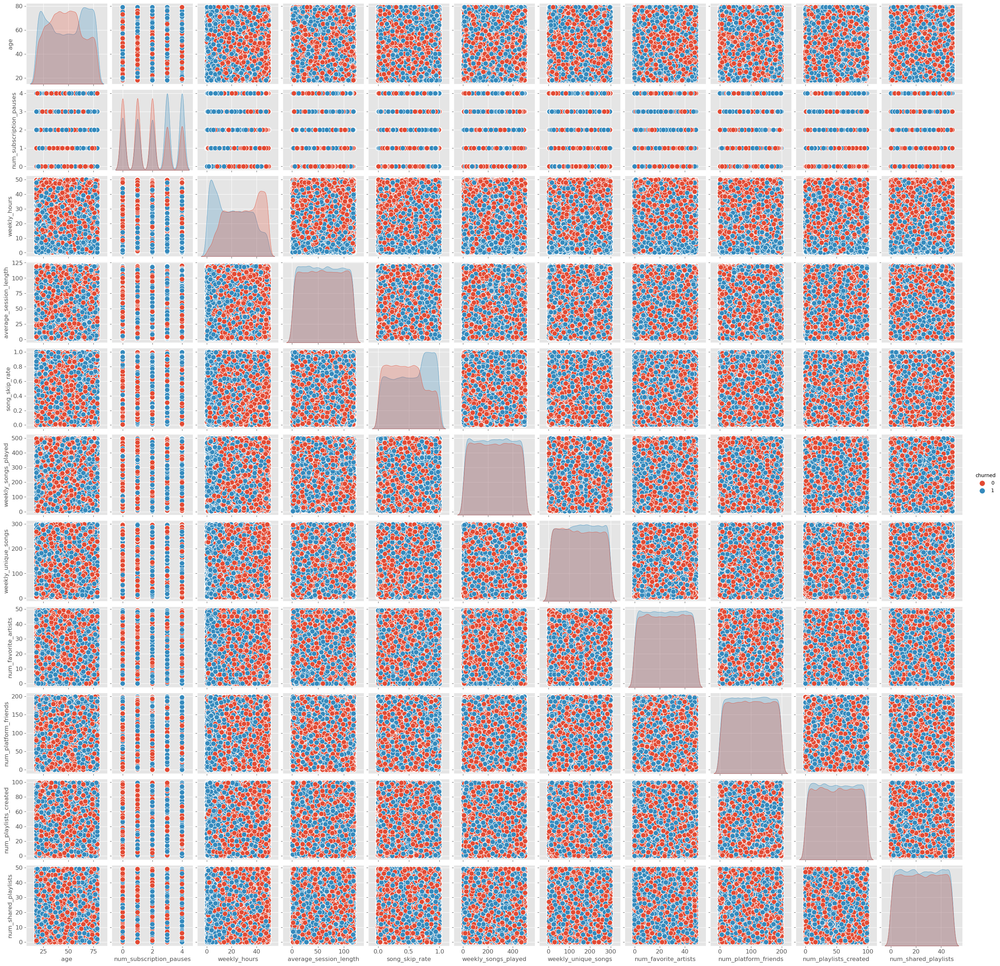

In [53]:
%%time
columns = ['age', 'num_subscription_pauses', 'churned', 'weekly_hours',
       'average_session_length', 'song_skip_rate', 'weekly_songs_played',
       'weekly_unique_songs', 'num_favorite_artists', 'num_platform_friends',
       'num_playlists_created', 'num_shared_playlists']

sns.pairplot(df.filter(columns).sample(100000), hue='churned')

In [55]:
fig = px.histogram(df, x="age", color="churned")

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

In [51]:
df_plot = df.loc[df.subscription_type=='Premium'] # iris is a pandas DataFrame
fig = px.scatter(df_plot, x="song_skip_rate", y="weekly_hours", color='churned')
fig.show()

In [10]:
fig = px.box(df, x="churned", y="song_skip_rate", color="churned", points='outliers')
fig.show()

In [56]:
fig = px.box(df, x="payment_plan", y="song_skip_rate", color="churned", points='outliers')
fig.show()

In [57]:
fig = px.box(df, x="subscription_type", y="song_skip_rate", color="churned", points='outliers')
fig.show()

In [54]:
fig = px.histogram(df, x="song_skip_rate", color="churned")

# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

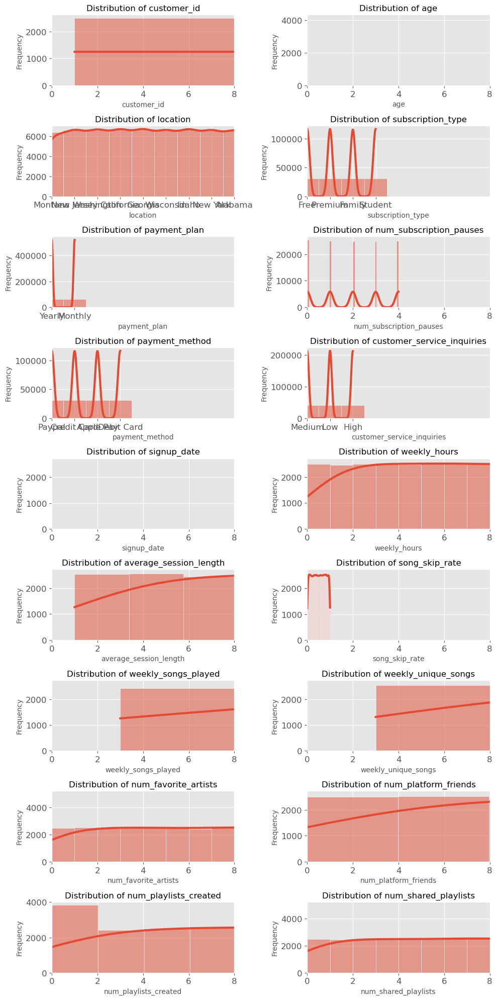

In [59]:
plt.figure(figsize=(10, 20))
n_features = len(df.columns[:-2])
n_rows = n_features // 2 + n_features % 2  # Calculate the number of rows needed

for i, feature in enumerate(df.columns[:-2]):
    plt.subplot(n_rows, 2, i+1)  # Adjust subplot layout dynamically
    sns.histplot(df[feature], kde=True)
    plt.title(f'Distribution of {feature}', fontsize=12)
    plt.xlabel(feature, fontsize=10)
    plt.ylabel('Frequency', fontsize=10)
    plt.xlim(0, 8)
    

plt.tight_layout()
plt.show()

# Prediction

In [85]:
from sklearn import metrics
from sklearn.metrics import classification_report 
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier

In [100]:
drop_columns = ['customer_id', 'location', 'subscription_type', 'payment_plan', 'payment_method', 'customer_service_inquiries']

df_final = df.drop(columns=drop_columns)

X = df_final.iloc[:, :-1] # preditoras ou varivaies explicativas
y = df_final.iloc[:, -1] # varival resposta

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=0)

In [101]:
tree = DecisionTreeClassifier(max_depth=3, min_samples_leaf=10, random_state=0)
tree.fit(X_train, y_train)
tree_prediction = tree.predict(X_test)
print(classification_report(y_test, tree_prediction))

              precision    recall  f1-score   support

           0       0.72      0.50      0.59     18233
           1       0.63      0.82      0.71     19267

    accuracy                           0.66     37500
   macro avg       0.68      0.66      0.65     37500
weighted avg       0.68      0.66      0.65     37500



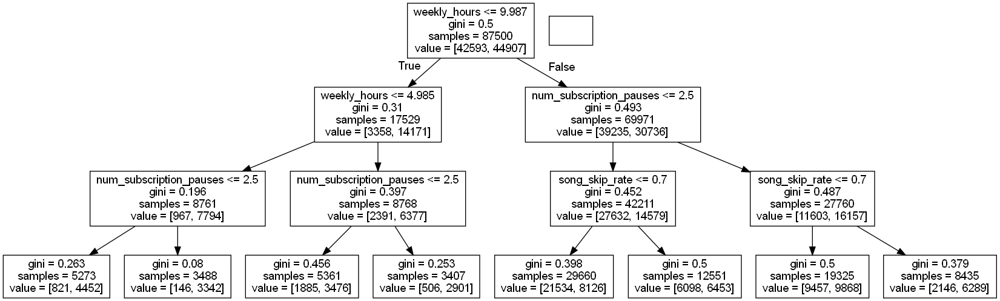

In [102]:
# Plotting of decission tree
from IPython.display import Image
from sklearn.tree import export_graphviz

#!pip install pydotplus
import pydotplus


features = X.columns
dot_data = export_graphviz(tree, out_file=None, feature_names=features)
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

In [123]:
%%time
rf = RandomForestClassifier(n_estimators=1000, random_state=42, min_samples_leaf=3, max_depth=10)
rf.fit(X_train, y_train)
rf_prediction = rf.predict(X_test)
print(classification_report(y_test, rf_prediction))

              precision    recall  f1-score   support

           0       0.69      0.76      0.72     18233
           1       0.75      0.68      0.71     19267

    accuracy                           0.72     37500
   macro avg       0.72      0.72      0.72     37500
weighted avg       0.72      0.72      0.72     37500

CPU times: total: 2min 9s
Wall time: 2min 9s


Text(0.5, 1.0, 'Feature Importance')

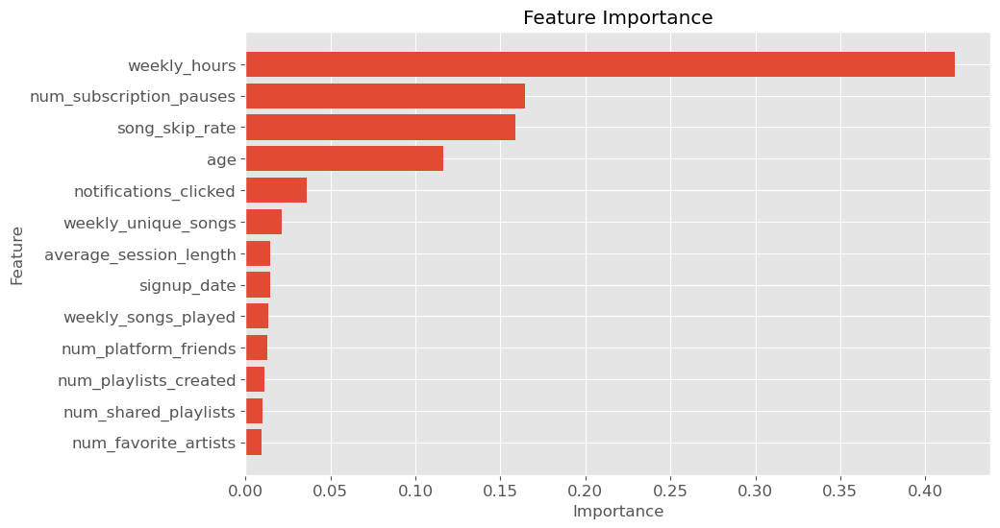

In [125]:
plt.figure(figsize=(10, 6))
global_importances = pd.Series(rf.feature_importances_, index=X_train.columns)
global_importances.sort_values(ascending=True, inplace=True)
plt.barh(width=global_importances.values, y=global_importances.index)
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.title("Feature Importance")

_______

# Sketch

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125000 entries, 0 to 124999
Data columns (total 20 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   customer_id                 125000 non-null  int64  
 1   age                         125000 non-null  int64  
 2   location                    125000 non-null  object 
 3   subscription_type           125000 non-null  object 
 4   payment_plan                125000 non-null  object 
 5   num_subscription_pauses     125000 non-null  int64  
 6   payment_method              125000 non-null  object 
 7   customer_service_inquiries  125000 non-null  object 
 8   signup_date                 125000 non-null  int64  
 9   weekly_hours                125000 non-null  float64
 10  average_session_length      125000 non-null  float64
 11  song_skip_rate              125000 non-null  float64
 12  weekly_songs_played         125000 non-null  int64  
 13  weekly_unique_

In [14]:
df.subscription_type.unique()

array(['Free', 'Premium', 'Family', 'Student'], dtype=object)

In [15]:
df.payment_plan.unique()

array(['Yearly', 'Monthly'], dtype=object)

In [16]:
df.churned.value_counts(normalize=False)

churned
1    64174
0    60826
Name: count, dtype: int64

In [17]:
df.churned.value_counts(normalize=True)

churned
1    0.513392
0    0.486608
Name: proportion, dtype: float64

In [18]:
df[['customer_id', 'age', 'subscription_type']]

,customer_id,age,subscription_type
0,1,32,Free
1,2,64,Free
2,3,51,Premium
3,4,63,Family
4,5,54,Family
...,...,...,...
124995,124996,32,Student
124996,124997,56,Premium
124997,124998,45,Family
124998,124999,69,Free


In [19]:
df.subscription_type

0            Free
1            Free
2         Premium
3          Family
4          Family
           ...   
124995    Student
124996    Premium
124997     Family
124998       Free
124999     Family
Name: subscription_type, Length: 125000, dtype: object

In [20]:
pd.get_dummies(df.subscription_type).columns

Index(['Family', 'Free', 'Premium', 'Student'], dtype='object')

In [21]:
df.isna().sum()

customer_id                   0
age                           0
location                      0
subscription_type             0
payment_plan                  0
num_subscription_pauses       0
payment_method                0
customer_service_inquiries    0
signup_date                   0
weekly_hours                  0
average_session_length        0
song_skip_rate                0
weekly_songs_played           0
weekly_unique_songs           0
num_favorite_artists          0
num_platform_friends          0
num_playlists_created         0
num_shared_playlists          0
notifications_clicked         0
churned                       0
dtype: int64